# Clustering and noise detection

In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.cluster import DBSCAN
from hdbscan import HDBSCAN
from sklearn.svm import OneClassSVM
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from copy import deepcopy
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

## Task 1

In [2]:
# Load the Ann-thyroid dataset
data = pd.read_csv(".\\annthyroid.data.csv")

# View the first few rows of the dataset
data.head()


,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22
0,0.73,0,1,0,0,0,0,0,1,0,...,0,0,0,0,0.00060,0.015,0.120,0.082,0.146,3
1,0.24,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0.00025,0.030,0.143,0.133,0.108,3
2,0.47,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0.00190,0.024,0.102,0.131,0.078,3
3,0.64,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0.00090,0.017,0.077,0.090,0.085,3
4,0.23,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0.00025,0.026,0.139,0.090,0.153,3


In [3]:
# Drop binary variables V2-V16
data = data.drop(data.columns[1:16], axis=1)

# View the updated dataset
data.head()


,V1,V17,V18,V19,V20,V21,V22
0,0.73,0.00060,0.015,0.120,0.082,0.146,3
1,0.24,0.00025,0.030,0.143,0.133,0.108,3
2,0.47,0.00190,0.024,0.102,0.131,0.078,3
3,0.64,0.00090,0.017,0.077,0.090,0.085,3
4,0.23,0.00025,0.026,0.139,0.090,0.153,3


In [4]:
# Split the dataset into a training set and a test set
train_set, test_set = train_test_split(data, test_size=0.2, random_state=42)

# View the size of the training and test sets
print("Training set size:", len(train_set))
print("Test set size:", len(test_set))


Training set size: 5760
Test set size: 1440


In [5]:
X_train = train_set.iloc[:,:-1]
y_train = train_set.iloc[:,-1]

X_test = test_set.iloc[:,:-1]
y_test = test_set.iloc[:,-1]

In [6]:

# Define the outlier detection algorithms
dbscan = DBSCAN()
hdbscan = HDBSCAN()
ocsvm = OneClassSVM(nu=0.05)
iforest = IsolationForest(n_estimators=100, contamination=0.05, random_state=42)
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)

# Fit the algorithms on the training set
dbscan.fit(X_test)
hdbscan.fit(X_test)
ocsvm.fit(X_train)
iforest.fit(X_train)
lof.fit(X_train)

X_test_extended = deepcopy(X_test)
# Predict the outliers on the training set
X_test_extended["dbscan"] = dbscan.labels_
X_test_extended["hdbscan"] = hdbscan.labels_
X_test_extended["ocsvm"] = ocsvm.predict(X_test)
X_test_extended["iforest"] = iforest.predict(X_test)
X_test_extended["lof"] = lof.fit_predict(X_test)


c:\Users\WOlejnik\anaconda3\envs\visualization\lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


In [7]:
X_test_extended["dbscan"].value_counts()

0    1440
Name: dbscan, dtype: int64

In [8]:
X_test_extended["hdbscan"].value_counts()

 1    1141
-1     294
 0       5
Name: hdbscan, dtype: int64

In [9]:
X_test_extended["ocsvm"].value_counts()

 1    1378
-1      62
Name: ocsvm, dtype: int64

In [10]:
X_test_extended["iforest"].value_counts()

 1    1383
-1      57
Name: iforest, dtype: int64

In [11]:
X_test_extended["lof"].value_counts()

 1    1368
-1      72
Name: lof, dtype: int64

In [12]:

# Define the metrics we want to use
metrics = {"AUC": roc_auc_score, "Accuracy": accuracy_score, "Precision": precision_score, "Recall": recall_score}
alg_col = {'DBSCAN': 'dbscan', 'HDBSCAN': 'hdbscan', 'OneClassSVM': 'ocsvm', 'IsolationForest': 'iforest', 'LocalOutlierFactor': 'lof'}

# Evaluate the algorithms on the test set
results = []
for algorithm in [dbscan, hdbscan, ocsvm, iforest, lof]:
    algorithm_name = algorithm.__class__.__name__
    y_pred = np.where(X_test_extended[alg_col[algorithm_name]] == 1, 1, 0)
    y_true = np.where(y_test == 3, 1, 0)
    scores = {}
    for metric_name, metric_func in metrics.items():
        scores[metric_name] = metric_func(y_true, y_pred)
    results.append({"Algorithm": algorithm_name, **scores})

# Print the results
for result in results:
    print(result)


{'Algorithm': 'DBSCAN', 'AUC': 0.5, 'Accuracy': 0.06111111111111111, 'Precision': 0.0, 'Recall': 0.0}
{'Algorithm': 'HDBSCAN', 'AUC': 0.6254370629370629, 'Accuracy': 0.7854166666666667, 'Precision': 0.9570552147239264, 'Recall': 0.8076923076923077}
{'Algorithm': 'OneClassSVM', 'AUC': 0.5315357719203874, 'Accuracy': 0.9083333333333333, 'Precision': 0.9426705370101597, 'Recall': 0.9607988165680473}
{'Algorithm': 'IsolationForest', 'AUC': 0.5878496503496504, 'Accuracy': 0.9243055555555556, 'Precision': 0.9493853940708604, 'Recall': 0.9711538461538461}
{'Algorithm': 'LocalOutlierFactor', 'AUC': 0.606508875739645, 'Accuracy': 0.9194444444444444, 'Precision': 0.9517543859649122, 'Recall': 0.9630177514792899}


c:\Users\WOlejnik\anaconda3\envs\visualization\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


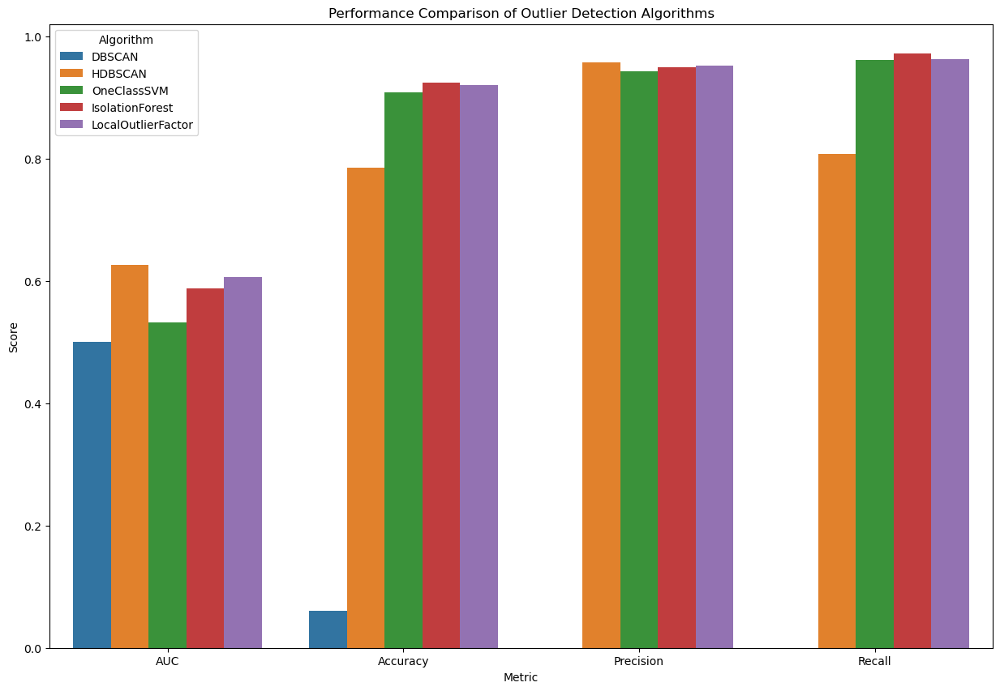

In [13]:
# Create a DataFrame with the results
df_results = pd.DataFrame(results)

# Melt the DataFrame to plot the metrics as columns
df_melt = df_results.melt(id_vars=["Algorithm"], var_name="Metric", value_name="Score")

# Plot the bar plot
plt.figure(figsize=(15,10))
sns.barplot(x="Metric", y="Score", hue="Algorithm", data=df_melt)
plt.title("Performance Comparison of Outlier Detection Algorithms")
plt.show()


In [14]:
X_test_extended

,V1,V17,V18,V19,V20,V21,dbscan,hdbscan,ocsvm,iforest,lof
3098,0.40,0.00240,0.0208,0.112,0.125,0.090,0,1,1,1,1
2531,0.35,0.00120,0.0270,0.137,0.119,0.115,0,1,1,1,1
4071,0.46,0.00130,0.0201,0.073,0.077,0.095,0,1,1,1,1
1287,0.73,0.00390,0.0090,0.062,0.054,0.115,0,-1,1,1,1
2540,0.71,0.00058,0.0208,0.119,0.108,0.110,0,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...
3790,0.61,0.00004,0.0201,0.115,0.083,0.138,0,1,1,1,1
911,0.82,0.00050,0.0060,0.139,0.086,0.161,0,1,1,1,1
6520,0.33,0.00080,0.0230,0.114,0.104,0.110,0,1,1,1,1
2995,0.61,0.00208,0.0130,0.092,0.089,0.103,0,1,1,1,1


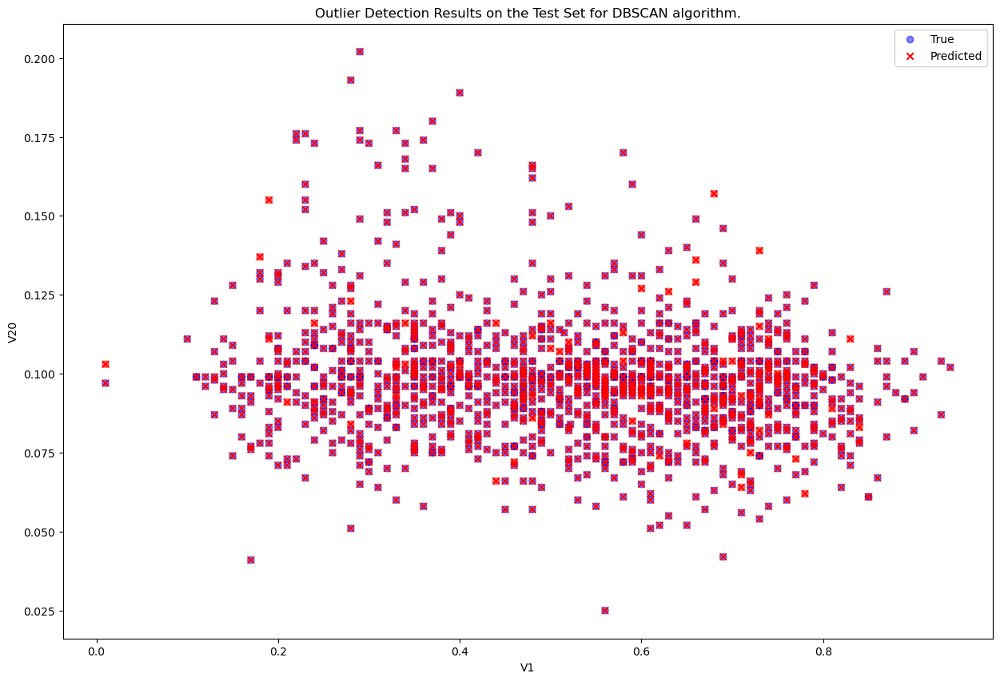

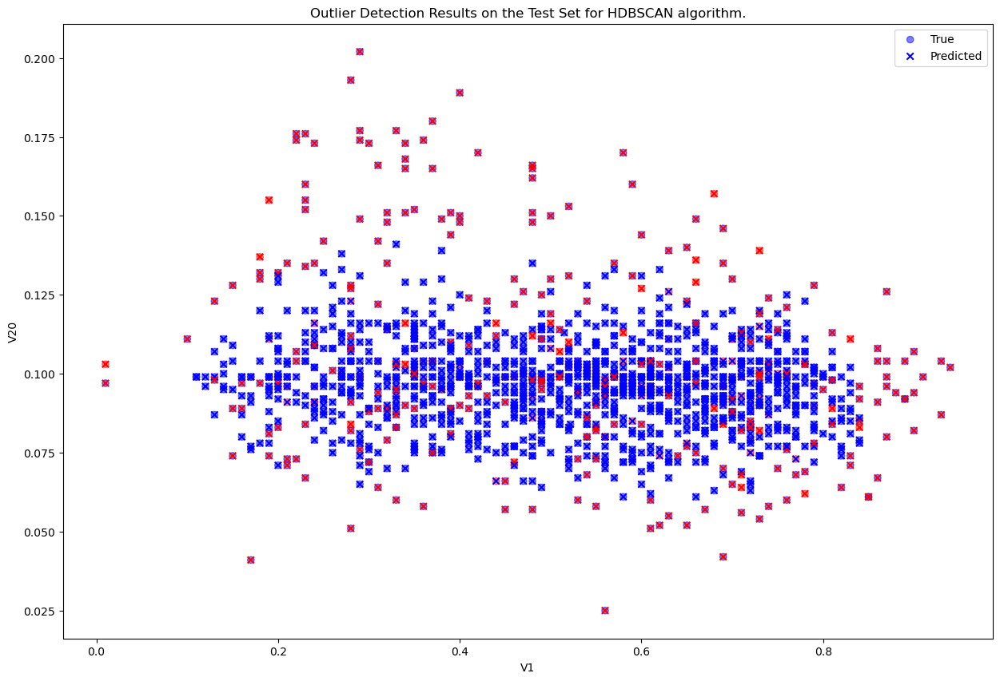

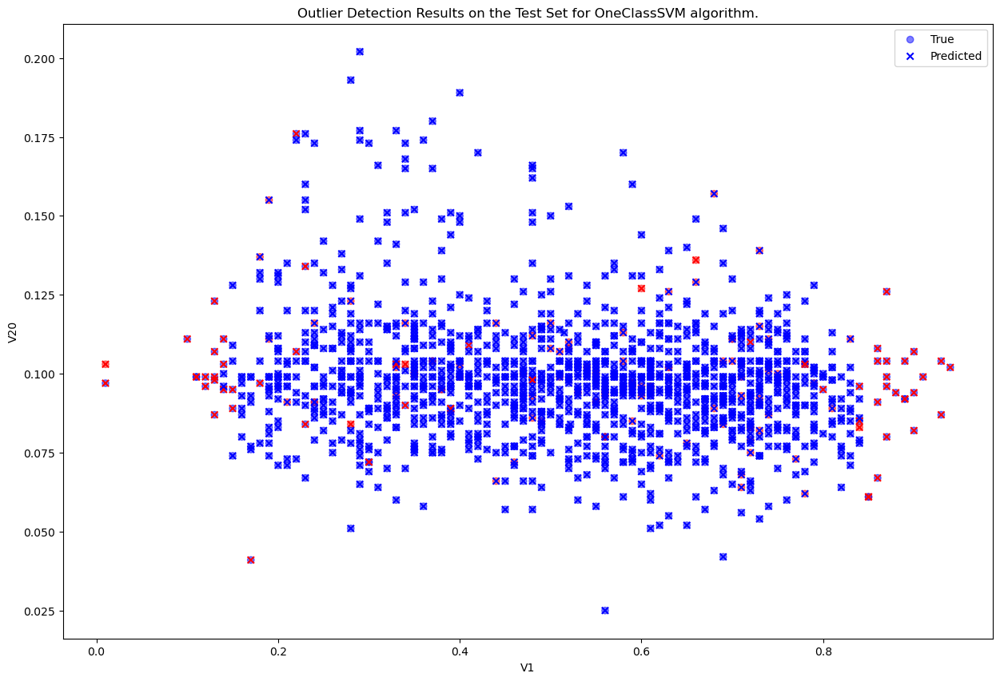

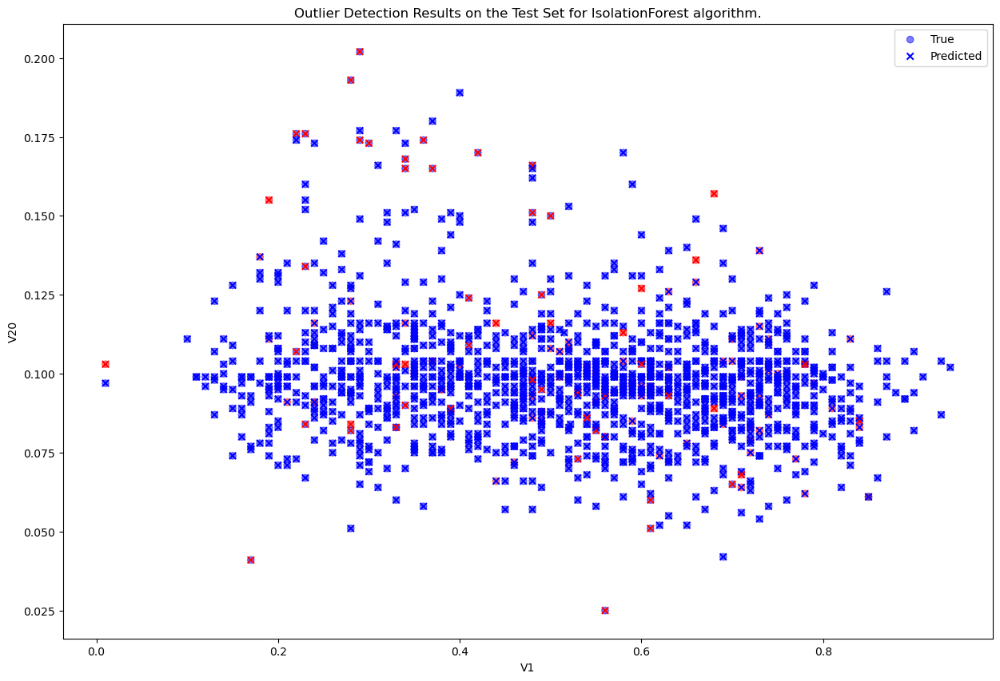

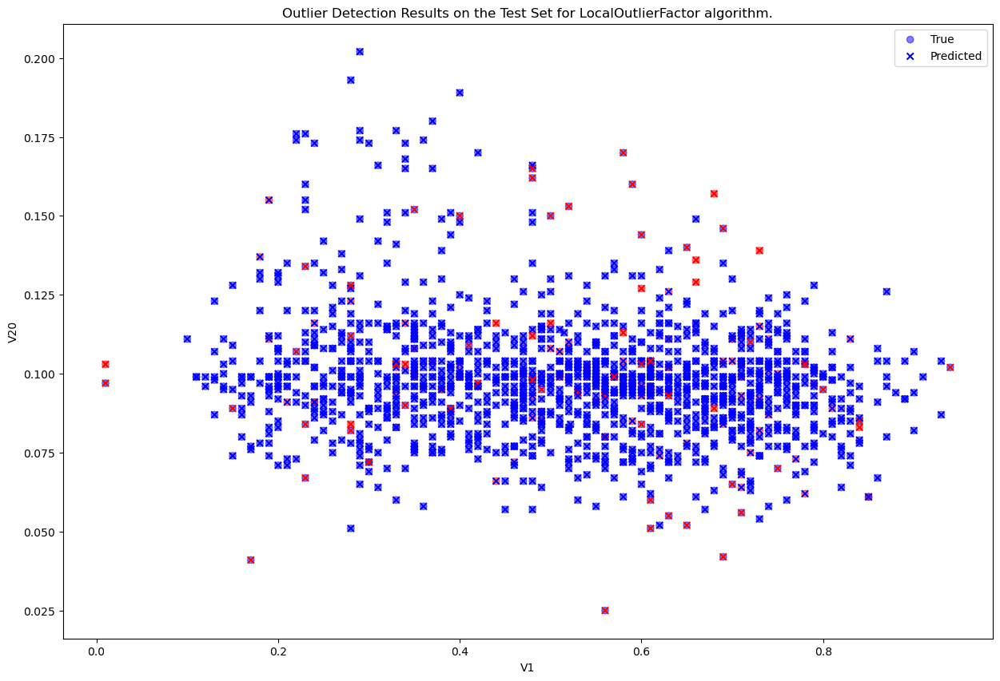

In [15]:
# Define the colors for the ground truth and predicted anomalies
for algorithm in [dbscan, hdbscan, ocsvm, iforest, lof]:
    algorithm_name = algorithm.__class__.__name__
    y_pred = np.where(X_test_extended[alg_col[algorithm_name]] == 1, 1, 0)
    y_true = np.where(y_test == 3, 1, 0)
    colors_true = np.where(y_true == 0, "red", "blue")
    colors_pred = np.where(y_pred == 0, "red", "blue")

    # Plot the scatter plot with the true and predicted anomalies
    
    plt.figure(figsize=(15,10))
    plt.scatter(test_set["V1"], test_set["V20"], c=colors_true, alpha=0.5, label="True")
    plt.scatter(test_set["V1"], test_set["V20"], c=colors_pred, marker="x", label="Predicted")
    plt.legend()
    plt.xlabel("V1")
    plt.ylabel("V20")
    plt.title(f"Outlier Detection Results on the Test Set for {algorithm_name} algorithm.")
    plt.show()


## Task 2

In [16]:
import clustbench
import os

In [17]:
data_path = os.path.join("clustering-results-v1-master")
battery = "wut"
print(clustbench.get_dataset_names(battery, path=data_path))
dataset = "labirynth"
b = clustbench.load_dataset(battery, dataset, path=data_path)

['labirynth']


In [18]:
def make_df(data, labels):
    x = data[:,0]
    y = data[:,1]
    dict = {'x': x, 'y': y, 'label': labels}
    # print(x.size, y.size, labels.size)
    df = pd.DataFrame.from_dict(dict)
    return df

def plot_clustering(data, labels, title, ax=None):
    df = make_df(data, labels)
    # plt.figure(figsize=(8,8))
    if ax:
        sns.scatterplot(data=df, x="x", y="y", hue="label", palette="hls", legend=False, ax=ax).set(title=title)
    else:
        sns.scatterplot(data=df, x="x", y="y", hue="label", palette="hls", legend=False).set(title=title)
    # plt.legend(loc="upper right")

def compare_clustering(data, labels, title, target_data=b.data, target_labels=b.labels[0]):
    fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(18,6))
    plot_clustering(data, labels, title, ax=ax1)
    plot_clustering(target_data, target_labels, "Target clustering", ax=ax2)


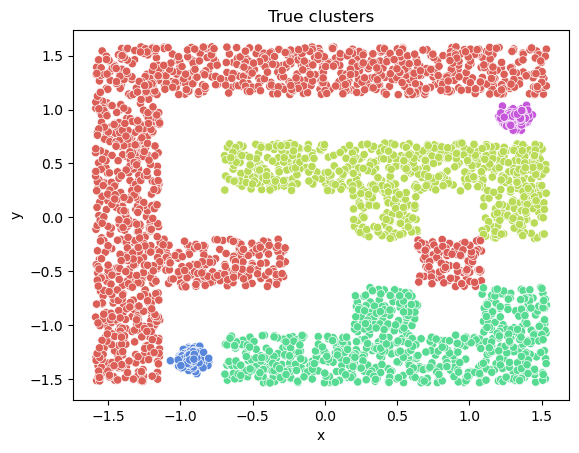

In [19]:
plot_clustering(b.data, b.labels[0], "True clusters")

In [20]:
def compare_results(method="*"):
    results_path = os.path.join("clustering-results-v1-master", "original")
    method_group = method  # or "*" for everything
    res = clustbench.load_results(
        method_group, b.battery, b.dataset, b.n_clusters, path=results_path
    )

    for k, v in res.items():
        label = np.array(v[6])
        compare_clustering(b.data, label, title=k)

### Genie Clustering Method
Genie is a clustering algorithm that is based on an ensemble of decision trees. It was introduced in the paper "Genie: A New, Fast, and Outlier Resilient Hierarchical Clustering Algorithm" by Jinze Liu and Xiaoyu Liu. The algorithm builds an ensemble of decision trees by randomly selecting subsets of features and instances, and then clustering the instances based on the trees. The final clustering is obtained by hierarchical agglomerative clustering.

Compared to other clustering algorithms, Genie is known for its speed and outlier resilience. It is also able to handle high-dimensional data and noisy data, making it a popular choice for clustering large and complex datasets.

#### Strengths and Weaknesses
Strengths:

- Fast and efficient for clustering large datasets
- Resilient to outliers and noise
- Able to handle high-dimensional data

Weaknesses:

- May not always be the best choice for all datasets, depending on the characteristics of the data
- Requires tuning of hyperparameters such as the number of decision trees and the subset size of features and instances
- May not scale well to extremely large datasets with millions of instances

#### Experiments
In this task, I have chosen a rather complex dataset that can be visualized on a two-dimensional plane. I then focused on comparing the different algorithms on the same dataset. My goal was to understand and visualize how each algorithm would perform on a complex problem.

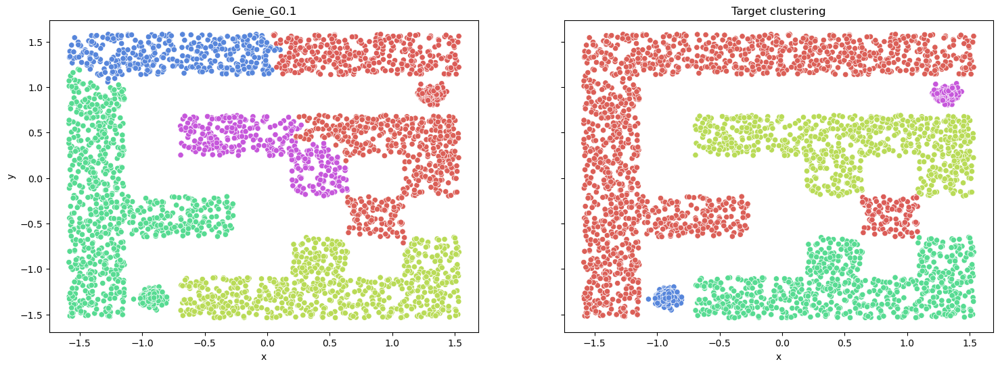

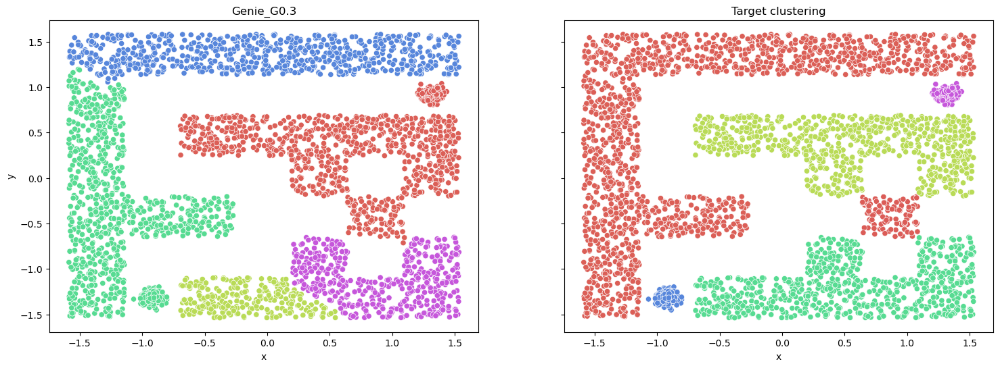

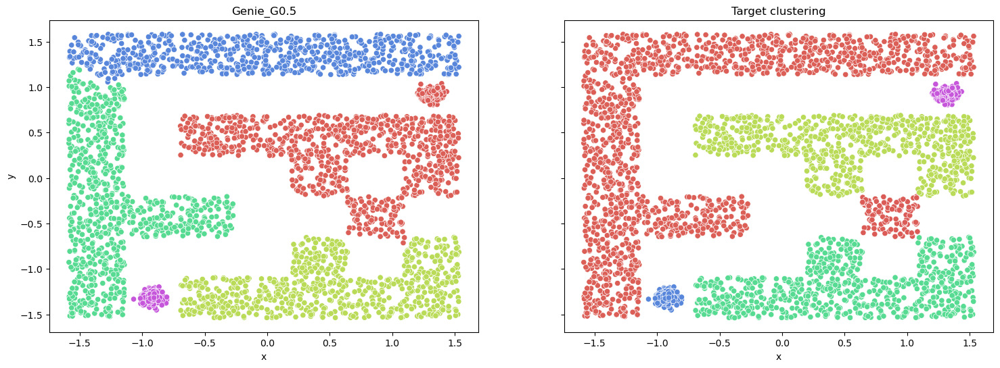

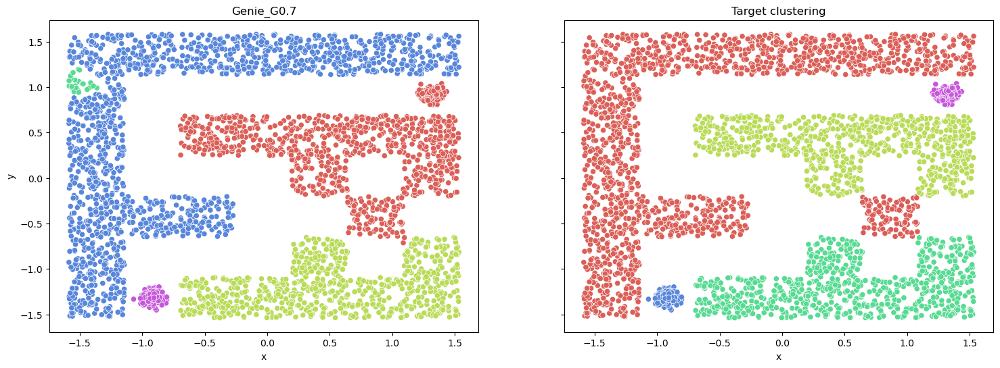

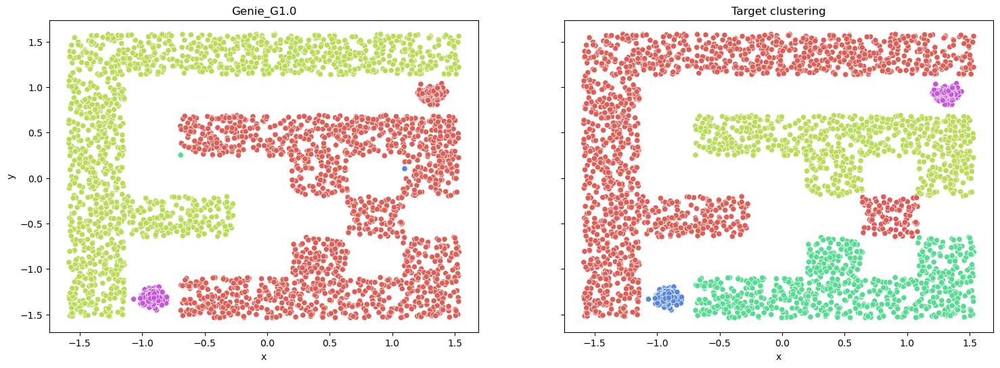

In [21]:
compare_results("Genie")

C:\Users\WOlejnik\AppData\Local\Temp\ipykernel_26300\2279500453.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True, figsize=(18,6))


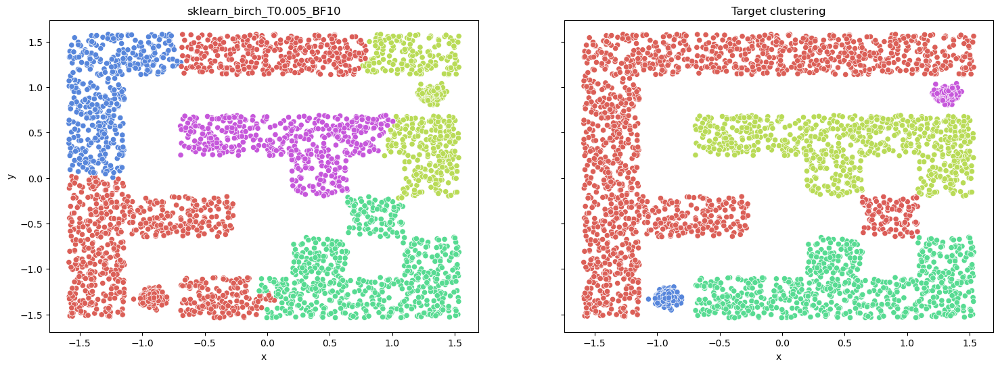

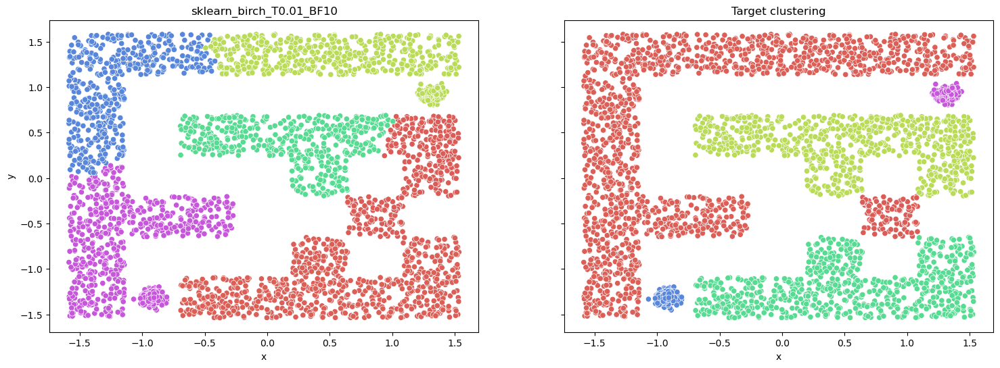

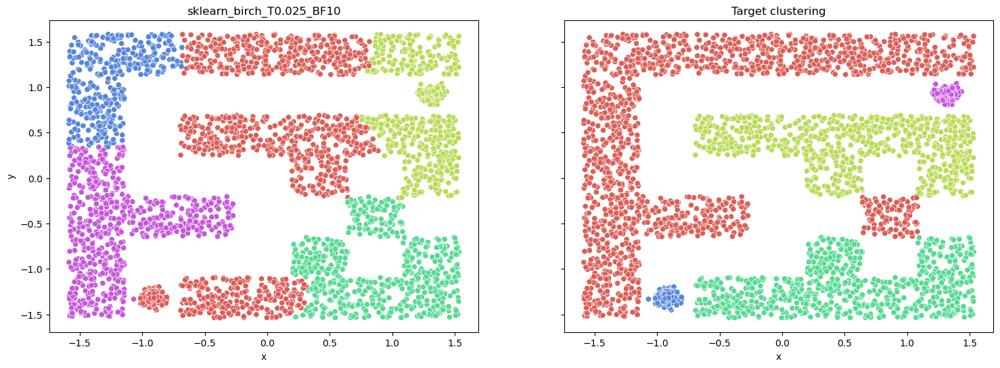

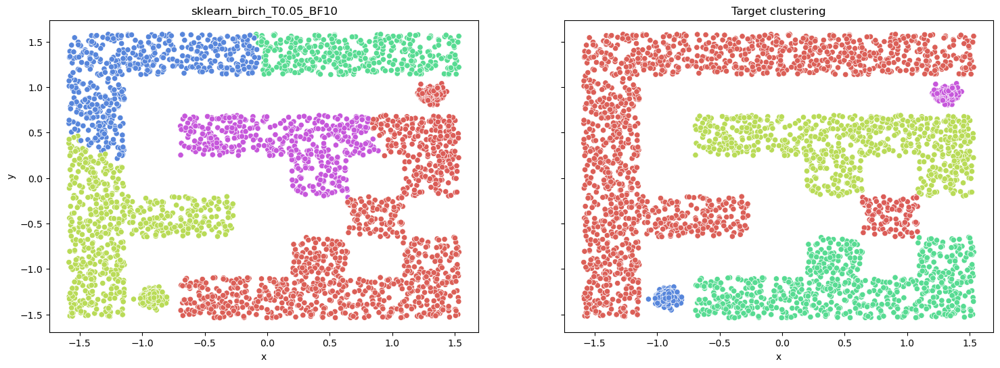

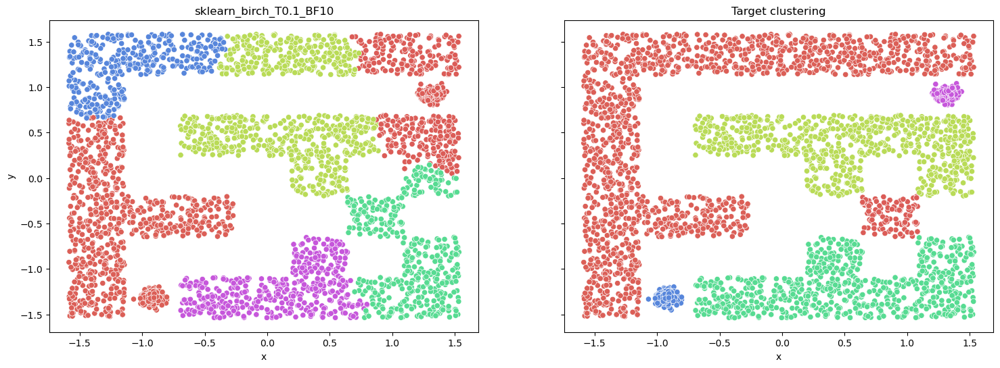

...

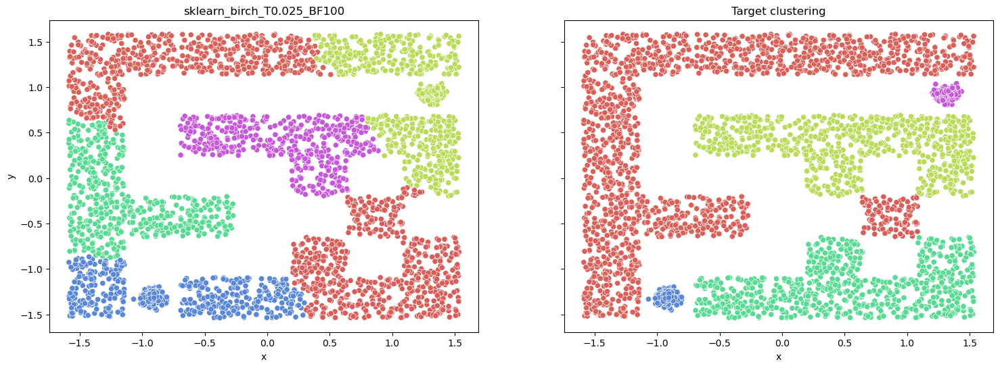

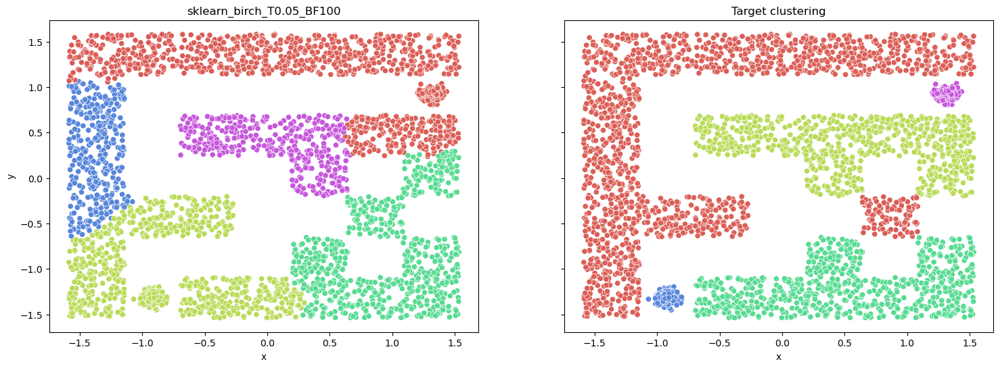

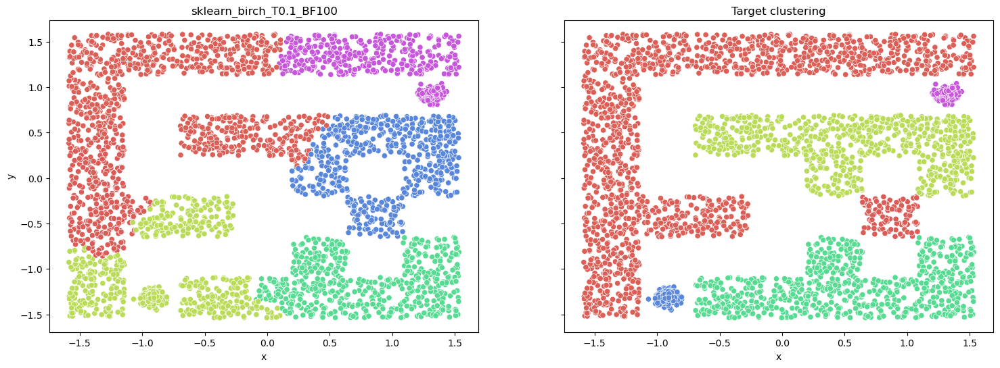

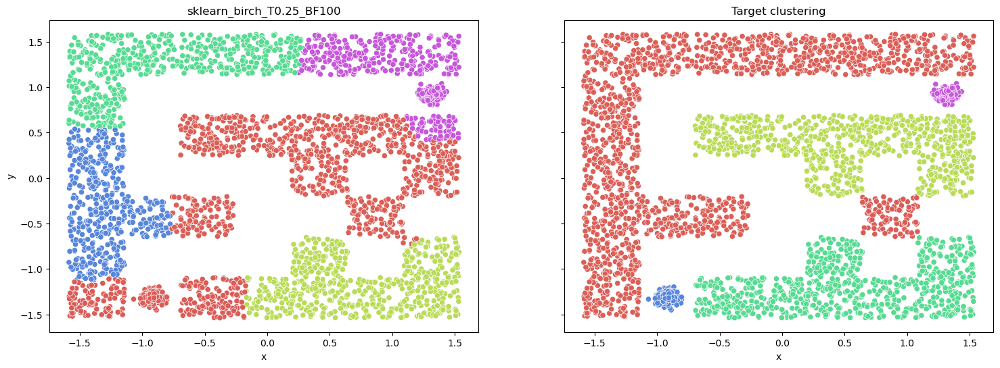

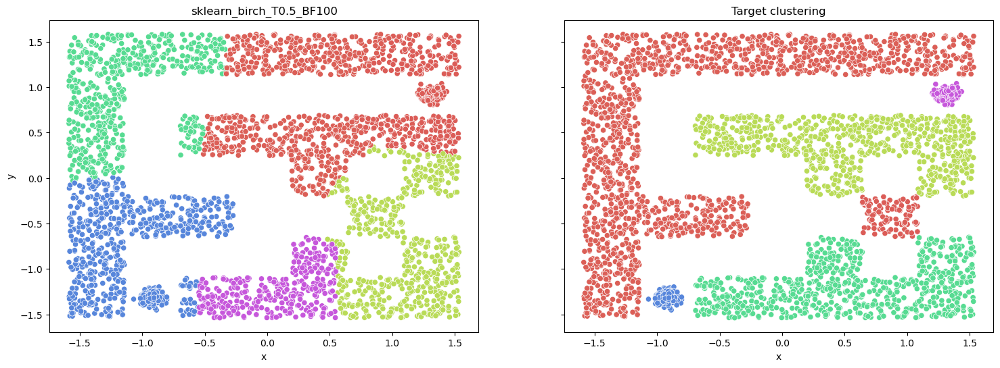

In [22]:
compare_results("sklearn_birch")

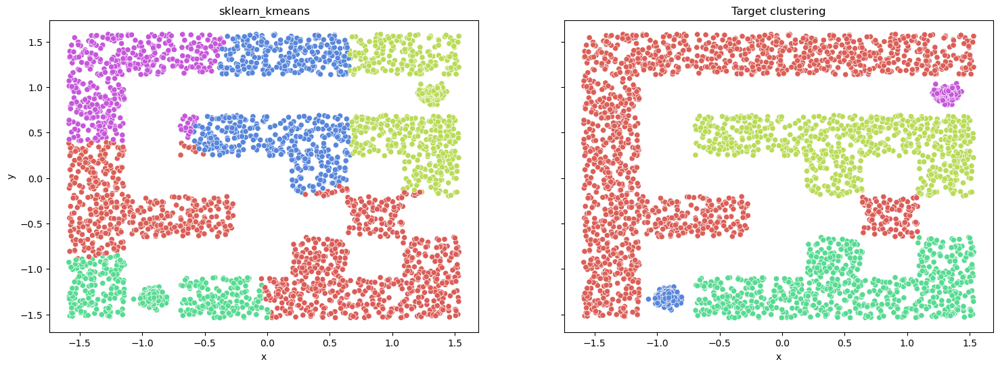

In [23]:
compare_results("sklearn_kmeans")

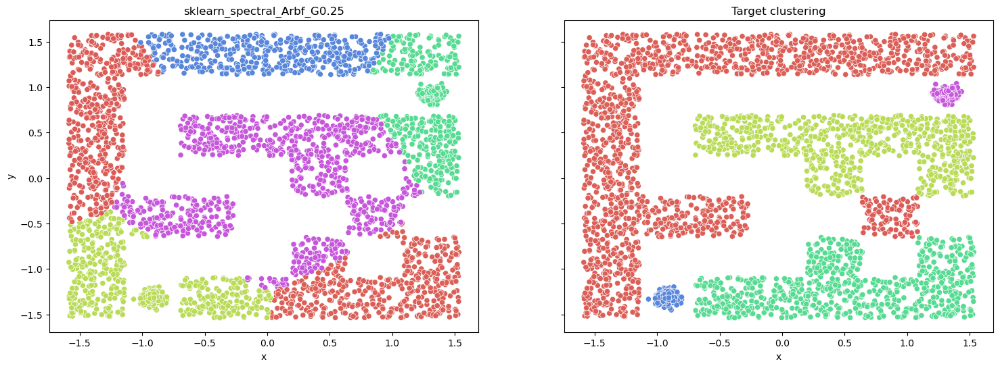

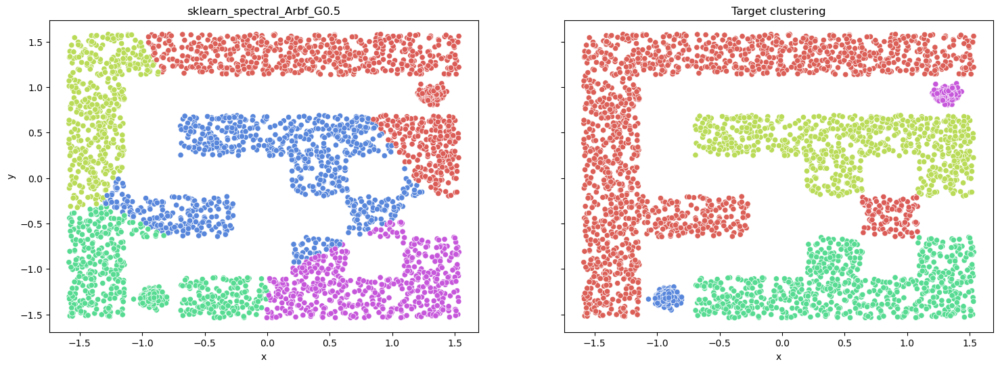

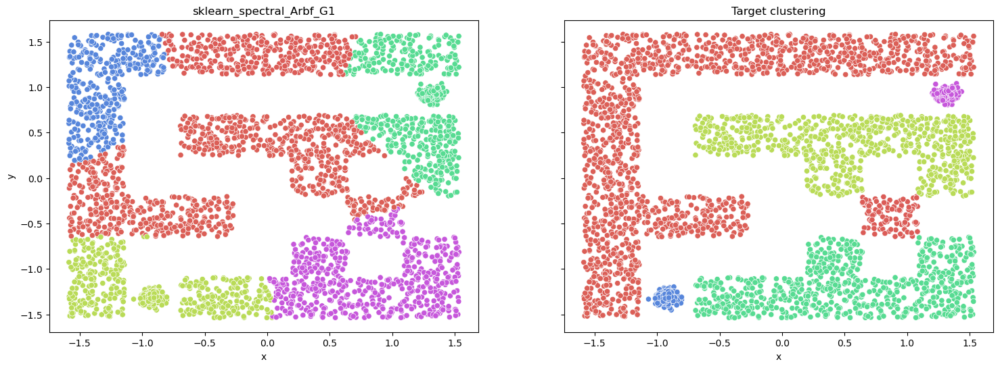

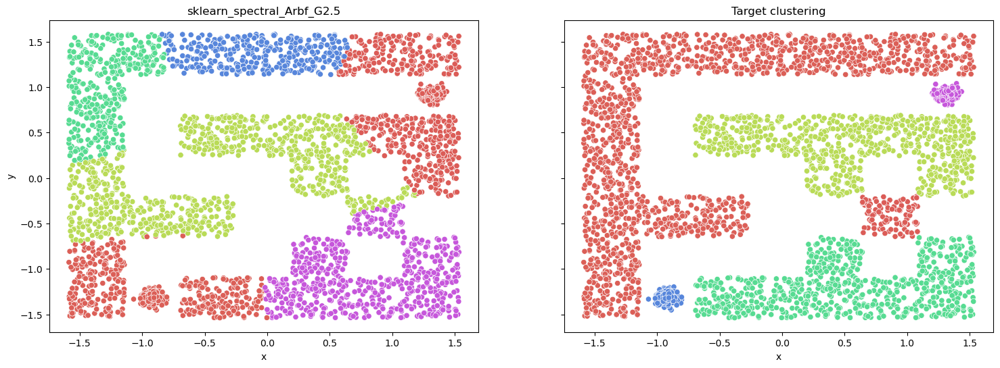

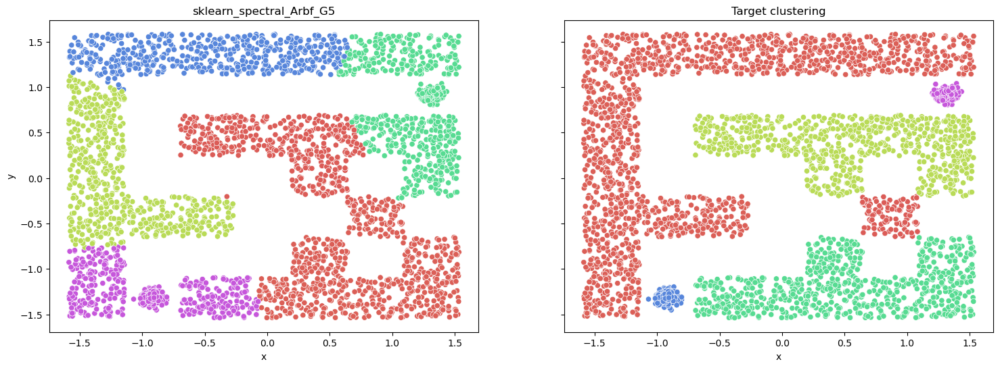

...

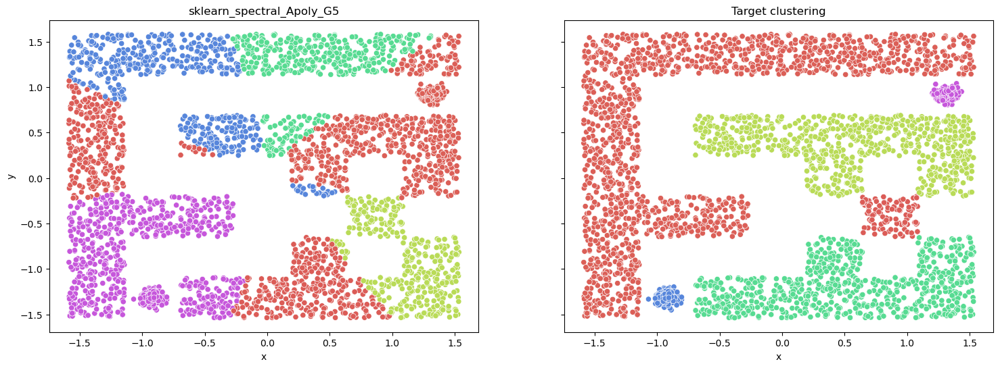

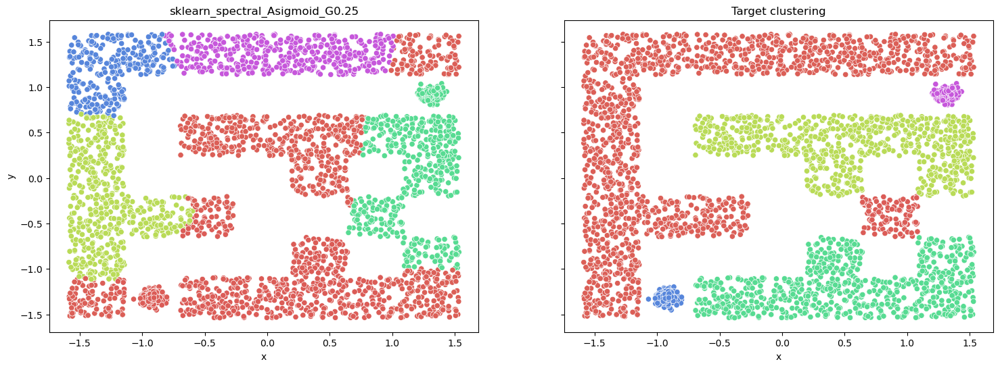

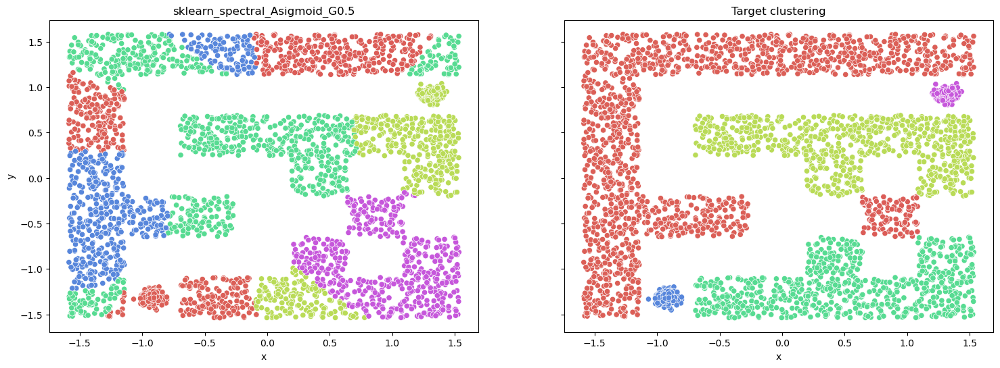

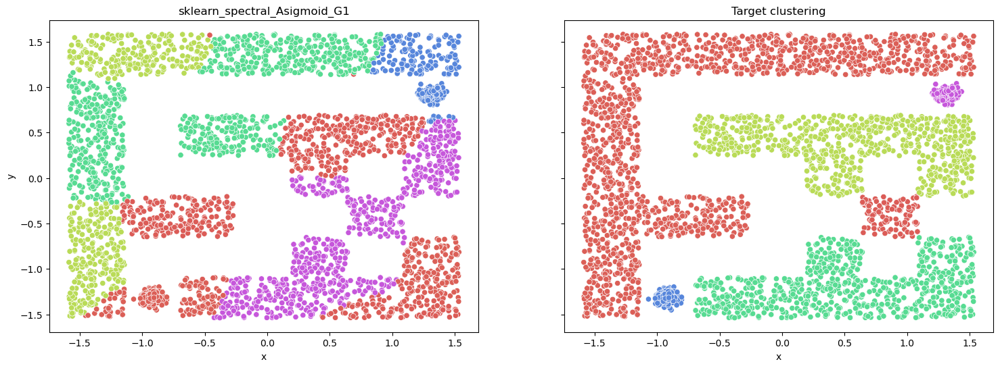

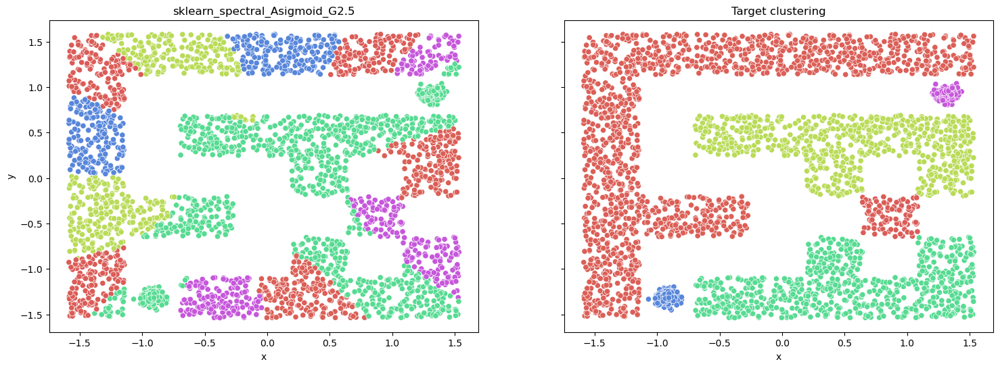

In [24]:
compare_results("sklearn_spectral")

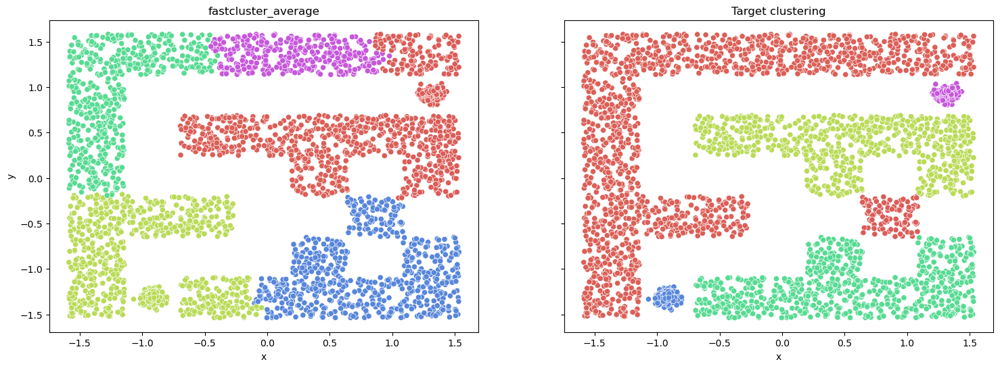

In [25]:
compare_results("fastcluster_average")

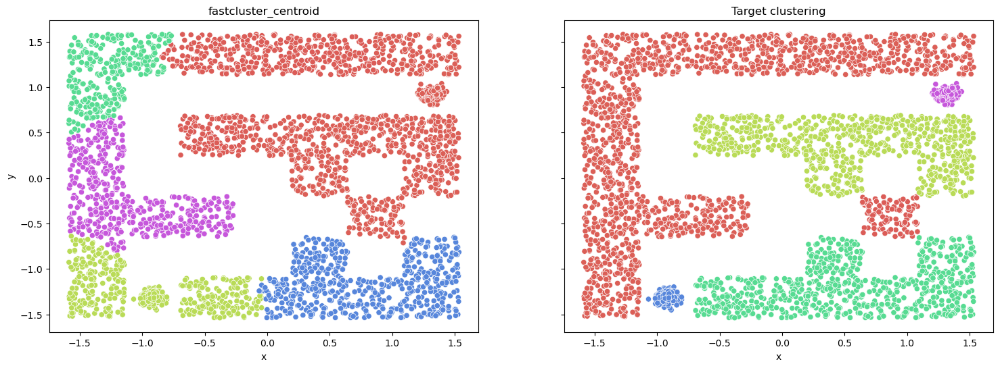

In [26]:
compare_results("fastcluster_centroid")

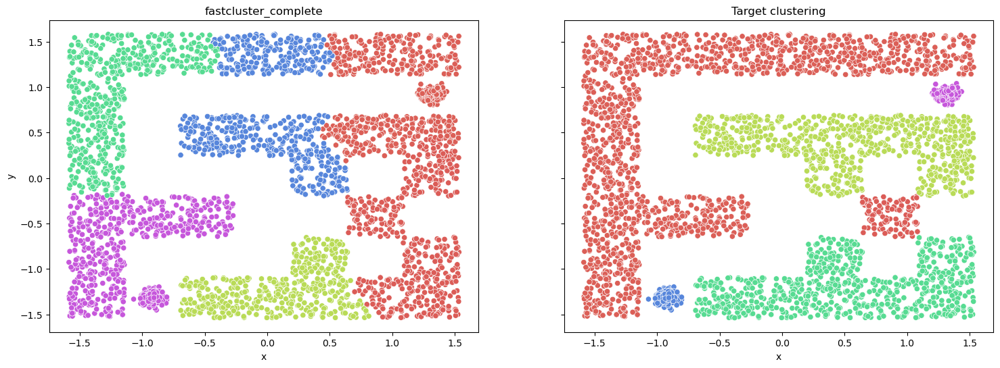

In [27]:
compare_results("fastcluster_complete")

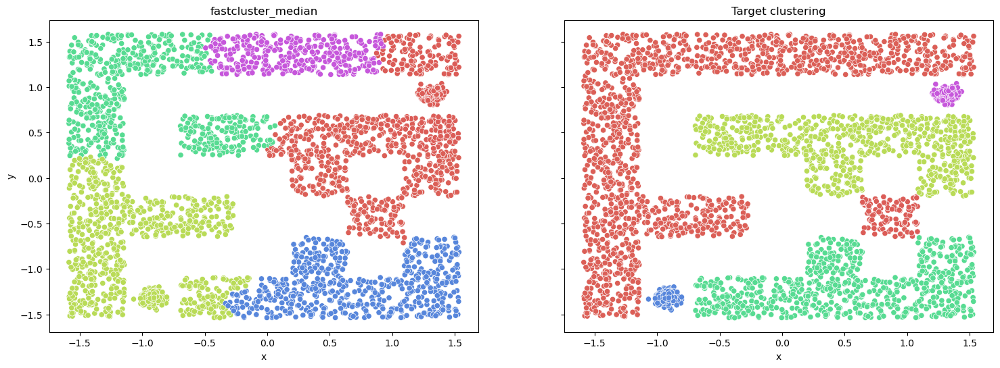

In [28]:
compare_results("fastcluster_median")

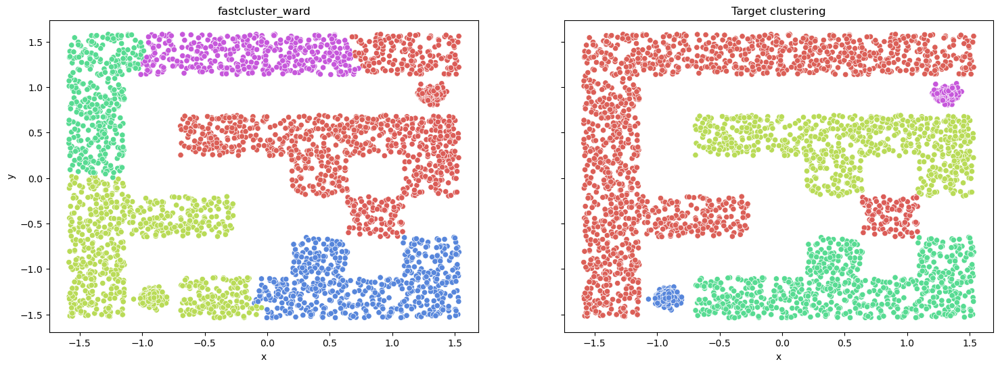

In [29]:
compare_results("fastcluster_ward")

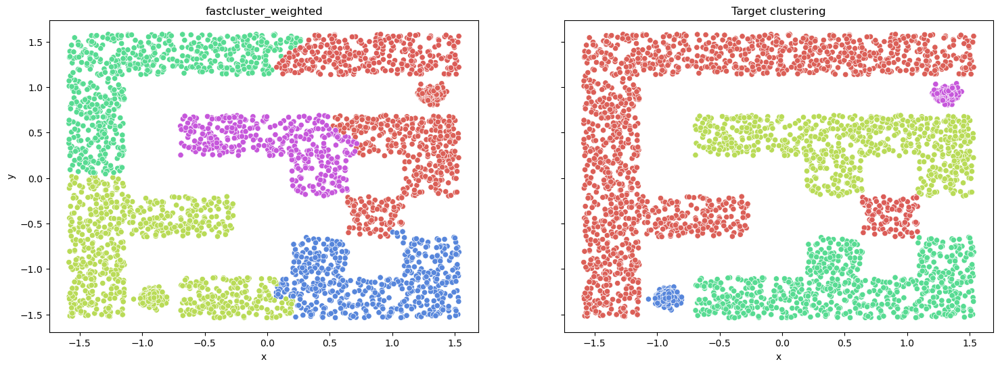

In [30]:
compare_results("fastcluster_weighted")